## Walktimes to MERGED
# Introduction

In this tutorial we will analyse walk times from ttc_stop points within the City of Toronto to the Toronto Transit Commission (TTC) Stops. MERGEDs can include subway, LRT, street car and bus. The analysis will use Panada to perform the network calculation. The results will be displayed City wide and at the level of an individual City of Toronto Neighbourhood Improvement Area. Neighbourhood Improvement Areas have been chosen as one of the domains used to determine them is the physical surroundings including access to transportation.

The analysis will use data from the City of Toronto's Open Data site including MERGED (https://open.toronto.ca/dataset/ttc-routes-and-schedules/), the City of Toronto's pedestrian network (https://open.toronto.ca/dataset/pedestrian-network/), Toronto One ttc_stop Repository ttc_stop point data (https://open.toronto.ca/dataset/ttc_stop-points-municipal-toronto-one-ttc_stop-repository/) and Neighbourhood Improvement Areas (https://open.toronto.ca/dataset/neighbourhood-improvement-areas/).

The TTC Routes and Schedules zip file contains route definitions, stop patterns, stop locations, and schedules. For this tutorial we will be using the stops.txt file.

The City of Toronto pedestrian network was a collective effort by the City of Toronto's Information and Technology Division's Data Analytics and Visualization team (DAV) and the City of Toronto's Transportation Services Division. A pedestrian network based on sidewalk centerlines and pedestrian-assets (e.g., sidewalks, crosswalks, pedestrian controlled crossings) was created with the focus being placed on the topological consistency over spatial accuracy. Meaning that the sidewalk centerlines are not necessarily spatially located along with the actual locations of the sidewalk geographically, but the connections between different sidewalk segments were maintained as being a higher priority.

The City of Toronto ttc_stop point data contains over 500,000 ttc_stop points within the city. A readme file is also included which explains the each of the attributes.

Neighbourhood Improvement Areas are specially-selected and designated neighbourhoods in the City of Toronto found to have inequities on several indicators of well-being. Currently 31 out of 140 neighbourhoods are designated as NIAs as part of the Toronto Strong Neighbourhoods 2020 (TSNS2020) project. Please see the link for further information (https://www.toronto.ca/city-government/data-research-maps/research-reports/social-reports/toronto-strong-neighbourhoods-strategy-2020/).

In [ ]:
!pip install geopandas

In [ ]:
!pip install psycopg2

In [ ]:
!pip install pandana

In [ ]:
!pip install basemap --user

In [ ]:
!pip install geoalchemy2

In [ ]:
!pip install mapclassify

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import pandana as pdna
import networkx as nx
from shapely.geometry import Polygon, LineString, Point, box
%matplotlib inline

## Step 1: Importing and Cleaning Data
# Importing Data
We can read the MERGED text file and create geometry using the latitude longitude columns supplied in the data. We can use the geopandas.read_file function to read the pednet, ttc_stop and Neighbourhood Improvement Areas ESRI shape files and reproject them to EPSG 2019. Please see the link for the description of EPSG 2019 (https://epsg.io/2019).

# Read MERGED Data
Read the MERGED data text file and create the spatial layer using the latitude and longitude provided in the file. The layer will be reprojected to EPSG 2019.

In [2]:
# Let's check out the .shp file instead (same dataset)
MERGED = gpd.read_file('merged.shp')
MERGED

,point_of_i,x,y,geometry
0,Child Care Center,304461.400215,4.828672e+06,POINT (304461.400 4828671.905)
1,Child Care Center,311217.445605,4.840433e+06,POINT (311217.446 4840433.213)
2,Child Care Center,330918.335077,4.850205e+06,POINT (330918.335 4850204.630)
3,Child Care Center,314172.948870,4.834207e+06,POINT (314172.949 4834207.161)
4,Child Care Center,322448.989348,4.840141e+06,POINT (322448.989 4840140.901)
...,...,...,...,...
1328,Youth Health Service,320164.828450,4.851127e+06,POINT (320164.828 4851126.963)
1329,Youth Health Service,296275.475450,4.843733e+06,POINT (296275.475 4843733.341)
1330,Youth Health Service,313405.787612,4.838395e+06,POINT (313405.788 4838395.286)
1331,Youth Health Service,306322.188598,4.835810e+06,POINT (306322.189 4835809.701)


In [3]:
MERGED.crs

<Projected CRS: EPSG:2019>
Name: NAD27(76) / MTM zone 10
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: Canada - Ontario - between 81°W and 78°W: south of 46°N in area to west of 80°15'W, south of 47°N in area between 80°15'W and 79°30'W, entire province between 79°30'W and 78°W.
- bounds: (-81.0, 42.26, -77.99, 47.33)
Coordinate Operation:
- name: MTM zone 10
- method: Transverse Mercator
Datum: North American Datum 1927 (1976)
- Ellipsoid: Clarke 1866
- Prime Meridian: Greenwich

### Explore MERGED

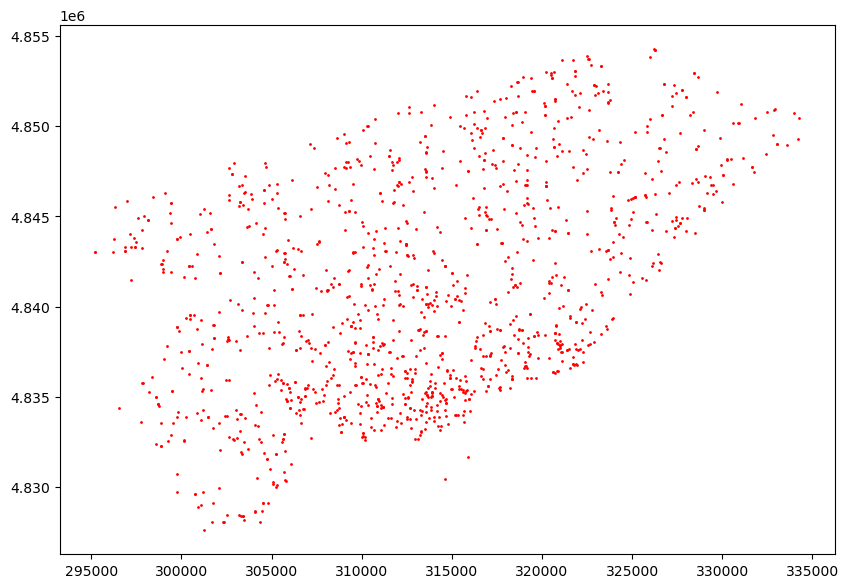

In [4]:
ax = MERGED.plot(figsize=(10, 10),color='red', markersize =1)

## Read Pedestrian Network Data
Read the Pedestrian Network line shape file and reproject to EPSG 2019

In [5]:
# reading pednet file
pednet = gpd.read_file("Pedestrian Network Data - 4326.zip")
pednet

,FIELD_1,FIELD_2,FIELD_3,FIELD_4,FIELD_5,FIELD_6,FIELD_7,FIELD_8,FIELD_9,FIELD_10,FIELD_11,geometry
0,696841,1,Local,7,Sidewalk on both sides,0,None,NaN,None,93.867680,129.824322,"LINESTRING (-79.56396 43.73782, -79.56293 43.7..."
1,696842,2,Collector,7,Sidewalk on both sides,0,None,NaN,None,32.546284,44.903807,"LINESTRING (-79.56792 43.63618, -79.56752 43.6..."
2,696843,3,None,2,Sidewalk on north side only,0,None,NaN,None,117.669206,162.522572,"LINESTRING (-79.37791 43.67845, -79.37652 43.6..."
3,696844,4,None,7,Sidewalk on both sides,0,None,NaN,None,223.269710,309.035596,"LINESTRING (-79.51852 43.70501, -79.51674 43.7..."
4,696845,5,Local,7,Sidewalk on both sides,0,None,NaN,None,201.335648,278.478601,"LINESTRING (-79.30122 43.77484, -79.29880 43.7..."
...,...,...,...,...,...,...,...,...,...,...,...,...
87100,783941,87101,Walkway,11,City walkway,1,ts,1430.0,ts,32.249129,44.584927,"LINESTRING (-79.57840 43.73537, -79.57803 43.7..."
87101,783942,87102,Walkway,11,City walkway,1,ts,1174.0,ts,26.786411,37.023492,"LINESTRING (-79.57050 43.71929, -79.57019 43.7..."
87102,783943,87103,Walkway,11,City walkway,1,ts,888.0,ts,32.846849,45.381530,"LINESTRING (-79.56002 43.69689, -79.55964 43.6..."
87103,783944,87104,Walkway,11,City walkway,1,ts,2137.0,ts,30.031629,41.511419,"LINESTRING (-79.57363 43.72572, -79.57327 43.7..."


In [6]:
pednet.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [7]:
# reprojecting epsg 4386 (wgs84) to epsg 2019 (mtm nad 27)
crs = {'init': 'epsg:4326'}
pednet = gpd.GeoDataFrame(pednet, crs=crs, geometry='geometry')
pednet = pednet.to_crs({'init': 'epsg:2019'})

C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [8]:
# remove length column to avoid confusion
# pednet = pednet[['OBJECTID', 'road_type', 'sdwlk_code', 'sdwlk_desc', 'crosswalk', 'cwalk_type', 'px', 'px_type','geometry']]
pednet = pednet[['FIELD_1', 'FIELD_3', 'FIELD_4', 'FIELD_5', 'FIELD_6', 'FIELD_7', 'FIELD_8', 'FIELD_9','geometry']]
pednet

,FIELD_1,FIELD_3,FIELD_4,FIELD_5,FIELD_6,FIELD_7,FIELD_8,FIELD_9,geometry
0,696841,Local,7,Sidewalk on both sides,0,None,NaN,None,"LINESTRING (299647.480 4843993.305, 299730.645..."
1,696842,Collector,7,Sidewalk on both sides,0,None,NaN,None,"LINESTRING (299319.487 4832701.797, 299351.915..."
2,696843,None,2,Sidewalk on north side only,0,None,NaN,None,"LINESTRING (314644.016 4837403.152, 314756.028..."
3,696844,None,7,Sidewalk on both sides,0,None,NaN,None,"LINESTRING (303307.301 4840346.899, 303450.851..."
4,696845,Local,7,Sidewalk on both sides,0,None,NaN,None,"LINESTRING (320802.305 4848122.923, 320996.750..."
...,...,...,...,...,...,...,...,...,...
87100,783941,Walkway,11,City walkway,1,ts,1430.0,ts,"LINESTRING (298484.120 4843722.537, 298514.329..."
87101,783942,Walkway,11,City walkway,1,ts,1174.0,ts,"LINESTRING (299119.187 4841934.761, 299144.363..."
87102,783943,Walkway,11,City walkway,1,ts,888.0,ts,"LINESTRING (299961.620 4839445.526, 299992.729..."
87103,783944,Walkway,11,City walkway,1,ts,2137.0,ts,"LINESTRING (298868.080 4842649.076, 298896.374..."


## Explore the Pedestrian Network Data
Create bar plot and plots of pednet

Create a bar plot showing the distribution of road types

<AxesSubplot:title={'center':'Pednet Road Type Distribution'}, xlabel='Road Types ', ylabel='Number'>

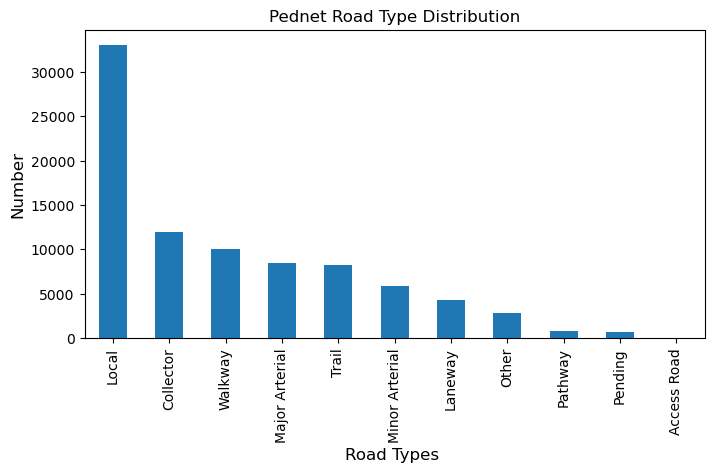

In [9]:
# distribution of road types in pednet

#plot
plt.figure(figsize=(8,4))
#ax= sns.barplot(x.index, x.values, alpha=0.8)
plt.title("Pednet Road Type Distribution")
plt.ylabel('Number', fontsize=12)
plt.xlabel('Road Types ', fontsize=12)

pednet.FIELD_3.value_counts().plot.bar()

### Create a plot of the city wide Pedestrian Network

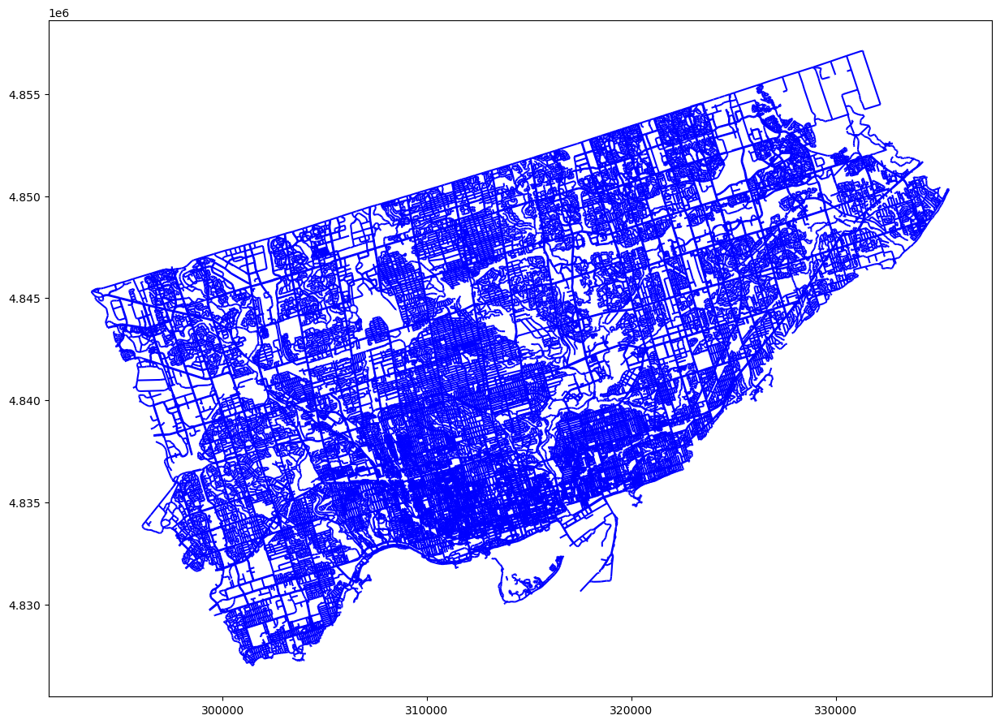

In [10]:
# plotting pednet layer
ax = pednet.plot(figsize=(15, 15),color='blue', markersize =1)

### Create a plot showing the Pedestrian Network at the city block level
In the plot below we see the cases where sidewalks are on both sides of the streets. Single lines represent several different features including local roads, walkways, laneways or private roads.

[(311000.0, 312000.0), (4834000.0, 4835000.0)]

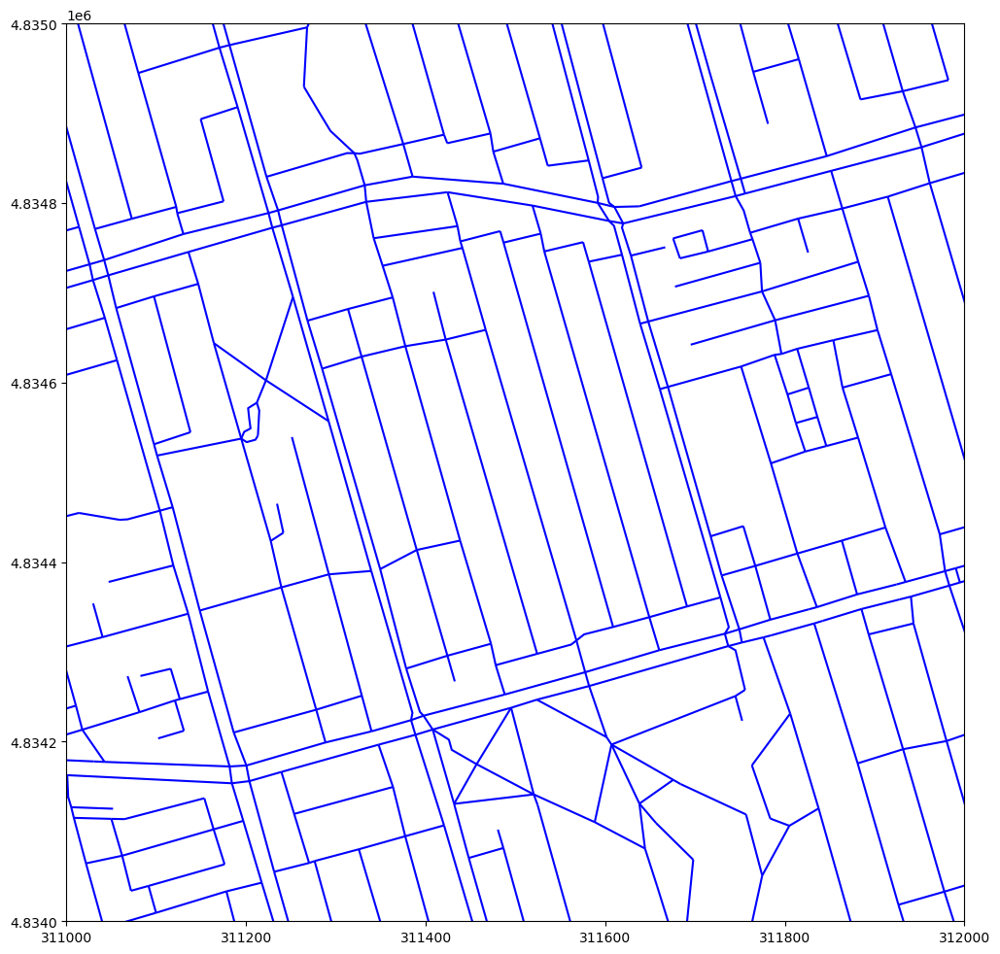

In [11]:
# plotting pednet layer with limits set
ax = pednet.plot(figsize=(12, 12),color='blue', markersize =1)
ax.set(xlim=(311000, 312000), ylim=(4834000, 4835000))

## Load TTC Stop Data
Read the TTC Stop file and reproject to EPSG 2019

In [12]:
# reading ttc stop csv file
# https://open.toronto.ca/dataset/ttc-routes-and-schedules/
# Go to Download Data
ttc_stop = pd.read_csv('./stops.txt', delimiter= ',')
ttc_stop

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station,stop_timezone,wheelchair_boarding
0,262,662,Danforth Rd at Kennedy Rd,NaN,43.714379,-79.260939,NaN,NaN,NaN,NaN,NaN,1
1,263,929,Davenport Rd at Bedford Rd,NaN,43.674448,-79.399659,NaN,NaN,NaN,NaN,NaN,1
2,264,940,Davenport Rd at Dupont St,NaN,43.675511,-79.401938,NaN,NaN,NaN,NaN,NaN,2
3,265,1871,Davisville Ave at Cleveland St,NaN,43.702088,-79.378112,NaN,NaN,NaN,NaN,NaN,1
4,266,11700,Disco Rd at Attwell Dr,NaN,43.701362,-79.594843,NaN,NaN,NaN,NaN,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...
9416,24516,16275,Gerrard St East at Yonge St,NaN,43.659208,-79.382000,NaN,NaN,NaN,NaN,NaN,1
9417,24517,16276,Gerrard St West at Bay St,NaN,43.658393,-79.385013,NaN,NaN,NaN,NaN,NaN,1
9418,24518,16277,Gerrard St West at Bay St,NaN,43.658626,-79.384739,NaN,NaN,NaN,NaN,NaN,1
9419,24519,16278,Gerrard St West at Elizabeth St,NaN,43.658079,-79.386494,NaN,NaN,NaN,NaN,NaN,1


In [13]:
#include columns needed for the project and renaming stop_lat and stop_lon columns
ttc_stop = ttc_stop[['stop_id', 'stop_code','stop_name','stop_lat', 'stop_lon']]
ttc_stop = ttc_stop.rename(columns={'stop_lat': 'latitude','stop_lon':'longitude' })
ttc_stop

,stop_id,stop_code,stop_name,latitude,longitude
0,262,662,Danforth Rd at Kennedy Rd,43.714379,-79.260939
1,263,929,Davenport Rd at Bedford Rd,43.674448,-79.399659
2,264,940,Davenport Rd at Dupont St,43.675511,-79.401938
3,265,1871,Davisville Ave at Cleveland St,43.702088,-79.378112
4,266,11700,Disco Rd at Attwell Dr,43.701362,-79.594843
...,...,...,...,...,...
9416,24516,16275,Gerrard St East at Yonge St,43.659208,-79.382000
9417,24517,16276,Gerrard St West at Bay St,43.658393,-79.385013
9418,24518,16277,Gerrard St West at Bay St,43.658626,-79.384739
9419,24519,16278,Gerrard St West at Elizabeth St,43.658079,-79.386494


In [14]:
# create geopanda dataframe add crs lat long
ttc_stop['geometry'] = list(zip(ttc_stop.longitude, ttc_stop.latitude))
ttc_stop['geometry'] = ttc_stop['geometry'].apply(Point)

# reprojecting epsg 4386 (wgs84) to epsg 2019 (mtm nad 27)
crs = {'init': 'epsg:4326'}
ttc_stop = gpd.GeoDataFrame(ttc_stop, crs=crs, geometry='geometry')
ttc_stop = ttc_stop.to_crs({'init': 'epsg:2019'})

# calculating x and y which will be used later to find nearest ttc stop to ttc_stop
ttc_stop['x'] = ttc_stop.geometry.x
ttc_stop['y'] = ttc_stop.geometry.y

C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [15]:
ttc_stop.crs

<Projected CRS: EPSG:2019>
Name: NAD27(76) / MTM zone 10
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Canada - Ontario - between 81°W and 78°W: south of 46°N in area to west of 80°15'W, south of 47°N in area between 80°15'W and 79°30'W, entire province between 79°30'W and 78°W.
- bounds: (-81.0, 42.26, -77.99, 47.33)
Coordinate Operation:
- name: MTM zone 10
- method: Transverse Mercator
Datum: North American Datum 1927 (1976)
- Ellipsoid: Clarke 1866
- Prime Meridian: Greenwich

In [16]:
ttc_stop

,stop_id,stop_code,stop_name,latitude,longitude,geometry,x,y
0,262,662,Danforth Rd at Kennedy Rd,43.714379,-79.260939,POINT (324064.544 4841414.808),324064.544438,4.841415e+06
1,263,929,Davenport Rd at Bedford Rd,43.674448,-79.399659,POINT (312891.267 4836955.833),312891.267226,4.836956e+06
2,264,940,Davenport Rd at Dupont St,43.675511,-79.401938,POINT (312707.354 4837073.706),312707.354330,4.837074e+06
3,265,1871,Davisville Ave at Cleveland St,43.702088,-79.378112,POINT (314624.256 4840028.795),314624.255719,4.840029e+06
4,266,11700,Disco Rd at Attwell Dr,43.701362,-79.594843,POINT (297155.498 4839945.292),297155.497545,4.839945e+06
...,...,...,...,...,...,...,...,...
9416,24516,16275,Gerrard St East at Yonge St,43.659208,-79.382000,POINT (314317.656 4835264.642),314317.655964,4.835265e+06
9417,24517,16276,Gerrard St West at Bay St,43.658393,-79.385013,POINT (314074.759 4835173.760),314074.758533,4.835174e+06
9418,24518,16277,Gerrard St West at Bay St,43.658626,-79.384739,POINT (314096.823 4835199.675),314096.823204,4.835200e+06
9419,24519,16278,Gerrard St West at Elizabeth St,43.658079,-79.386494,POINT (313955.350 4835138.712),313955.349969,4.835139e+06


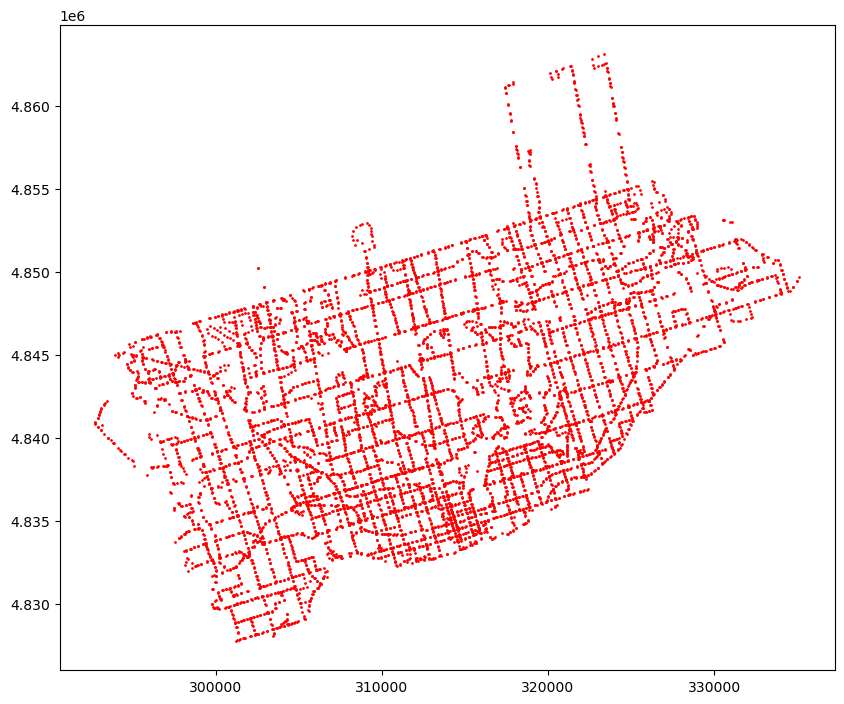

In [17]:
ax = ttc_stop.plot(figsize=(10, 10),color='red', markersize =1)

In [ ]:
# reading municipal ttc_stop point shape file
# https://open.toronto.ca/dataset/ttc_stop-points-municipal-toronto-one-ttc_stop-repository/
# Go to Download Data
#ttc_stop = gpd.read_file("Municipal ttc_stop points (wgs84) - geojson.zip")
#ttc_stop

In [ ]:
# change column names from upper to lower case
#ttc_stop.columns = map(str.lower, ttc_stop.columns)

#include columns needed for the project
#ttc_stop = ttc_stop[['geo_id', 'maint_stag','ttc_stop','lfname','x','y','longitude','latitude','objectid','mun_name','ward_name','geometry']]
#ttc_stop

In [ ]:
#ttc_stop.crs

In [ ]:
# reprojecting epsg 4386 (wgs84) to epsg 2019 (mtm nad 27)
#crs = {'init': 'epsg:4326'}
#ttc_stop = gpd.GeoDataFrame(ttc_stop, crs=crs, geometry='geometry')
#ttc_stop = ttc_stop.to_crs({'init': 'epsg:2019'})

### Explore ttc_stop point data

In [ ]:
#ax = ttc_stop.plot(figsize=(15, 15),color='blue', markersize =1)

### Create a plot showing the ttc_stop point data at the city block level


[(311200.0, 311800.0), (4834200.0, 4834800.0)]

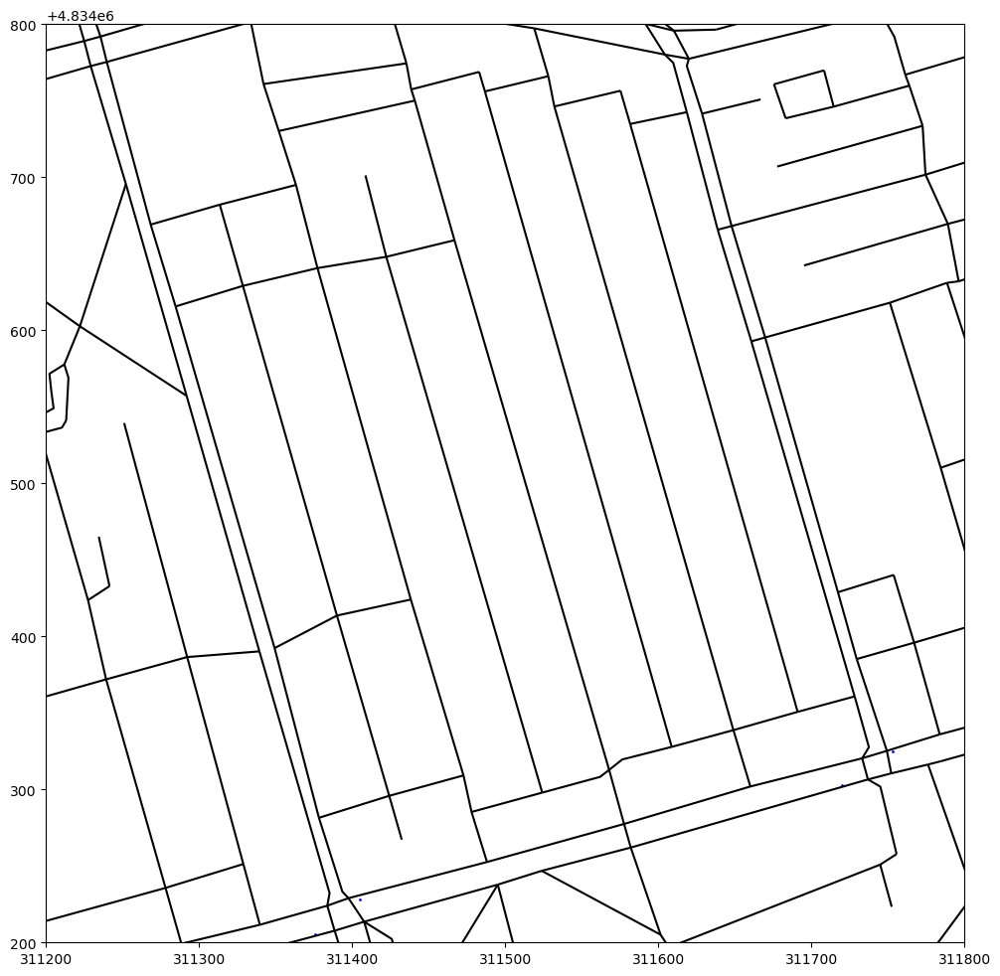

In [18]:
# plotting ttc_stop layer with limits set
ax = ttc_stop.plot(figsize=(12, 12),color='blue', markersize =1)
pednet.plot(ax=ax,color='black', markersize =2)
ax.set(xlim=(311200, 311800), ylim=(4834200, 4834800))

## Neighbourhood Improvement Areas
Read the Neighbourhood Improvement Areas polygon shape file and reproject to EPSG 2019

In [19]:
# reading Neighbourhood Improvement Areas polygon shape file
# https://open.toronto.ca/dataset/neighbourhood-improvement-areas/
# Go to Download Data
nia = gpd.read_file("neighbourhood-improvement-areas-wgs84.zip")
nia

,AREA_ID,DATE_EFF,DATE_EXP,AREA_AT_ID,AREA_TP_ID,PARNT_AREA,AREA_TYPE,AREA_CL_ID,AREA_CL,AREA_S_CD,...,FEAT_CD,FEAT_C_DSC,TR_ID_CRT,TR_ID_EXP,X,Y,LONGITUDE,LATITUDE,OBJECTID,geometry
0,25886593,2014-05-12,3000-01-01,25926665,602,49885,CNBH,0,None,027,...,0,None,105211,-1,305679.417,4847086.588,-79.488883,43.765736,16491553.0,"POLYGON ((-79.50529 43.75987, -79.50488 43.759..."
1,25886723,2014-05-12,3000-01-01,25926718,602,49885,CNBH,0,None,003,...,0,None,105211,-1,299670.030,4844005.846,-79.563491,43.737988,16492401.0,"POLYGON ((-79.57751 43.73384, -79.57806 43.734..."
2,25886334,2014-05-12,3000-01-01,25926719,602,49885,CNBH,0,None,055,...,0,None,105211,-1,316874.178,4840655.317,-79.349984,43.707749,16492417.0,"POLYGON ((-79.33542 43.70320, -79.33573 43.703..."
3,25886704,2014-05-12,3000-01-01,25926708,602,49885,CNBH,0,None,028,...,0,None,105211,-1,304938.033,4841073.295,-79.498091,43.711609,16492241.0,"POLYGON ((-79.50384 43.70288, -79.50425 43.704..."
4,25886515,2014-05-12,3000-01-01,25926709,602,49885,CNBH,0,None,139,...,0,None,105211,-1,327594.737,4844116.308,-79.216813,43.738652,16492257.0,"POLYGON ((-79.21397 43.72676, -79.21400 43.726..."
5,25886994,2014-05-12,3000-01-01,25926710,602,49885,CNBH,0,None,085,...,0,None,105211,-1,309678.766,4832752.918,-79.439338,43.636700,16492273.0,"POLYGON ((-79.42778 43.62979, -79.42948 43.630..."
6,25886342,2014-05-12,3000-01-01,25926716,602,49885,CNBH,0,None,061,...,0,None,105211,-1,321236.202,4839247.968,-79.295901,43.694998,16492369.0,"POLYGON ((-79.28776 43.68978, -79.29269 43.688..."
7,25886613,2014-05-12,3000-01-01,25926790,602,49885,CNBH,0,None,021,...,0,None,105211,-1,300261.014,4846330.825,-79.556175,43.758920,16493553.0,"POLYGON ((-79.58064 43.76302, -79.57754 43.763..."
8,25886658,2014-05-12,3000-01-01,25926791,602,49885,CNBH,0,None,022,...,0,None,105211,-1,301371.929,4844609.257,-79.542367,43.743430,16493569.0,"POLYGON ((-79.52628 43.73640, -79.52649 43.736..."
9,25886693,2014-05-12,3000-01-01,25926778,602,49885,CNBH,0,None,044,...,0,None,105211,-1,318269.615,4841566.821,-79.332646,43.715930,16493361.0,"POLYGON ((-79.33791 43.70770, -79.33788 43.707..."


In [20]:
# change column names from upper to lower case
nia.columns = map(str.lower, nia.columns)

#include columns needed for the project
nia = nia[['area_id','area_s_cd','area_name','geometry']]
nia

,area_id,area_s_cd,area_name,geometry
0,25886593,027,York University Heights (27),"POLYGON ((-79.50529 43.75987, -79.50488 43.759..."
1,25886723,003,Thistletown-Beaumond Heights (3),"POLYGON ((-79.57751 43.73384, -79.57806 43.734..."
2,25886334,055,Thorncliffe Park (55),"POLYGON ((-79.33542 43.70320, -79.33573 43.703..."
3,25886704,028,Rustic (28),"POLYGON ((-79.50384 43.70288, -79.50425 43.704..."
4,25886515,139,Scarborough Village (139),"POLYGON ((-79.21397 43.72676, -79.21400 43.726..."
5,25886994,085,South Parkdale (85),"POLYGON ((-79.42778 43.62979, -79.42948 43.630..."
6,25886342,061,Taylor-Massey (61),"POLYGON ((-79.28776 43.68978, -79.29269 43.688..."
7,25886613,021,Humber Summit (21),"POLYGON ((-79.58064 43.76302, -79.57754 43.763..."
8,25886658,022,Humbermede (22),"POLYGON ((-79.52628 43.73640, -79.52649 43.736..."
9,25886693,044,Flemingdon Park (44),"POLYGON ((-79.33791 43.70770, -79.33788 43.707..."


In [21]:
nia.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [22]:
# reprojecting epsg 4386 (wgs84) to epsg 2019 (mtm nad 27)
crs = {'init': 'epsg:4326'}
nia = gpd.GeoDataFrame(nia, crs=crs, geometry='geometry')
nia = nia.to_crs({'init': 'epsg:2019'})

C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


### Explore Neighbourhood Improvement Areas

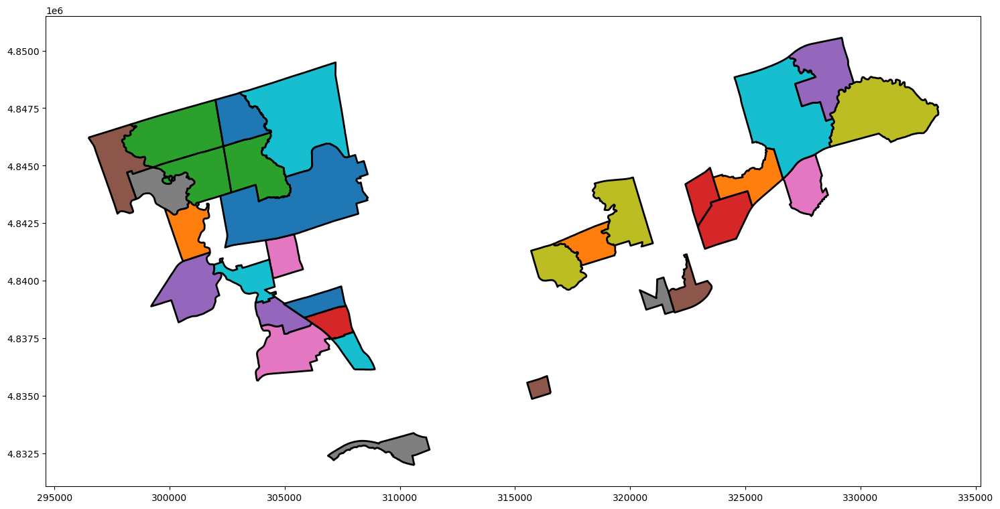

In [23]:
# plot Neighbourhood Improvement Areas
ax = nia.plot(figsize=(18, 13), column='area_name',edgecolor='black', linewidth=2)

# Step 2: Build Pandana Network
Pandana is a Python package that uses contraction hierarchies to perform rapid network calculations including shortest paths and accessibility buffers.

The link provides an introduction to the Pandana Network (https://udst.github.io/pandana/introduction.html).

## Create Network Graph Code Function

In [24]:
# creating network graph code
def create_graph(gdf, precision=3):
    '''Create a networkx given a GeoDataFrame of lines. Every line will
    correspond to two directional graph edges, one forward, one reverse. The
    original line row and direction will be stored in each edge. Every node
    will be where endpoints meet (determined by being very close together) and
    will store a clockwise ordering of incoming edges.
    '''
      
    G = nx.Graph()

    def make_node(coord, precision):
        return tuple(np.round(coord, precision))

    # Edges are stored as (from, to, data), where from and to are nodes.
    def add_edges(row, G):
        geometry = row.geometry
        coords = list(geometry.coords)
        geom_r = LineString(coords[::-1])
        coords_r = geom_r.coords
        start = make_node(coords[0], precision)
        end = make_node(coords[-1], precision)
        # Add forward edge
        fwd_attr ={}
        for k,v in row.items():
            fwd_attr[k]=v
        fwd_attr['forward']= 1
       #fwd_attr['geometry']=  geometry
        fwd_attr['length']=  geometry.length

        fwd_attr['visited']= 0

        G.add_edge(start, end, **fwd_attr)

    gdf.apply(add_edges, axis=1, args=[G])

    return G

### Create a network graph from the function above


In [25]:
# creating network graph
G = create_graph(pednet)
#from G to urbanaccess network model - one node idx,x,y one edge from to weight
G.edges(data=True)

EdgeDataView([((299647.48, 4843993.305), (299730.645, 4843949.766), {'FIELD_1': 696841, 'FIELD_3': 'Local', 'FIELD_4': 7, 'FIELD_5': 'Sidewalk on both sides', 'FIELD_6': 0, 'FIELD_7': None, 'FIELD_8': nan, 'FIELD_9': None, 'geometry': <shapely.geometry.linestring.LineString object at 0x000001F6203A1608>, 'forward': 1, 'length': 93.87182927984912, 'visited': 0}), ((299647.48, 4843993.305), (299602.64, 4844063.116), {'FIELD_1': 780939, 'FIELD_3': 'Local', 'FIELD_4': 7, 'FIELD_5': 'Sidewalk on both sides', 'FIELD_6': 0, 'FIELD_7': None, 'FIELD_8': nan, 'FIELD_9': None, 'geometry': <shapely.geometry.linestring.LineString object at 0x000001F6207B8808>, 'forward': 1, 'length': 82.97147056625764, 'visited': 0}), ((299730.645, 4843949.766), (299811.934, 4843907.77), {'FIELD_1': 722552, 'FIELD_3': 'Local', 'FIELD_4': 3, 'FIELD_5': 'No sidewalk on either side', 'FIELD_6': 0, 'FIELD_7': None, 'FIELD_8': nan, 'FIELD_9': None, 'geometry': <shapely.geometry.linestring.LineString object at 0x000001F6

In [26]:
# get network "from" and "to" from nodes
edges = nx.to_pandas_edgelist(G,'from','to')
to = edges['to'].tolist()
fr = edges['from'].tolist()
fr = list(set(fr))
to = list(set(to))
to.extend(fr)
nodes = list(set(to))
nodes = pd.DataFrame(nodes)
nodes.columns=['x', 'y']
nodes['xy'] = nodes.apply(lambda z: (z.x,z.y),axis=1)

In [27]:
# Assigning node ids to to_node and from_node

nodes['id'] = nodes.index
edges['to_node']=edges['to'].map(nodes.set_index('xy').id)
edges['from_node']=edges['from'].map(nodes.set_index('xy').id)
edges

,from,to,geometry,FIELD_8,FIELD_7,FIELD_3,FIELD_6,FIELD_1,visited,length,FIELD_4,forward,FIELD_9,FIELD_5,to_node,from_node
0,"(299647.48, 4843993.305)","(299730.645, 4843949.766)",LINESTRING (299647.4801773648 4843993.30454792...,NaN,None,Local,0,696841,0,93.871829,7,1,None,Sidewalk on both sides,64150,36406
1,"(299647.48, 4843993.305)","(299602.64, 4844063.116)",LINESTRING (299602.6398887987 4844063.11581814...,NaN,None,Local,0,780939,0,82.971471,7,1,None,Sidewalk on both sides,25903,36406
2,"(299730.645, 4843949.766)","(299811.934, 4843907.77)",LINESTRING (299730.64456459746 4843949.7660014...,NaN,None,Local,0,722552,0,91.496355,3,1,None,No sidewalk on either side,39647,64150
3,"(299730.645, 4843949.766)","(299783.527, 4844033.238)",LINESTRING (299730.64456459746 4843949.7660014...,NaN,None,Local,0,738428,0,98.813743,7,1,None,Sidewalk on both sides,49430,64150
4,"(299319.487, 4832701.797)","(299351.915, 4832699.012)",LINESTRING (299319.48713045556 4832701.7969447...,NaN,None,Collector,0,696842,0,32.547298,7,1,None,Sidewalk on both sides,21177,43712
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87091,"(327229.441, 4852966.294)","(327237.367, 4853015.687)",LINESTRING (327229.4406646615 4852966.29367340...,NaN,None,Minor Arterial,0,781934,0,50.025415,7,1,None,Sidewalk on both sides,20725,21457
87092,"(307051.475, 4834711.445)","(307056.406, 4834694.336)",LINESTRING (307051.4754708746 4834711.44545915...,NaN,None,Local,0,781991,0,17.805959,7,1,None,Sidewalk on both sides,46428,1087
87093,"(309342.013, 4837279.095)","(309284.58, 4837260.629)",LINESTRING (309284.58048275416 4837260.6294444...,NaN,None,Laneway,0,783712,0,60.328226,10,1,None,Laneway without any sidewalks,60133,16828
87094,"(321401.322, 4836954.751)","(321449.636, 4836949.596)",LINESTRING (321401.32159512583 4836954.7514345...,NaN,None,Laneway,0,783735,0,48.588611,10,1,None,Laneway without any sidewalks,59081,8076


### Creating and Saving Pandana Network
Create the Pandana Network and save the file in case you lose the network in memory

In [28]:
# creating pandana network

transit_ped_net = pdna.Network(nodes["x"],
                               nodes["y"],
                               edges["from_node"],
                               edges["to_node"],
                               pd.DataFrame([edges['length']]).T,
                               twoway=True)

# saving walkability file is optional. It can be used in the next steps if you don't have transit_ped_net in memory
transit_ped_net.save_hdf5('./walkability.hd5')

### Reading Pandana Network file
This step is only required if you do not already have transit_ped_net in memory

In [29]:
transit_ped_net = pdna.Network.from_hdf5('walkability.hd5')

### Precompute a Horizon Distance
It’s probably a good idea to precompute a given horizon distance so that aggregations don’t perform the network queries unnecessarily. This is done by calling the following code, where 1000 meters is used as the horizon distance:

In [30]:
#precompute a given horizon distance of 1000 meters
transit_ped_net.precompute(1000)
transit_ped_net.edges_df

,from,to,length
0,36406,64150,93.871829
1,36406,25903,82.971471
2,64150,39647,91.496355
3,64150,49430,98.813743
4,43712,21177,32.547298
...,...,...,...
87091,21457,20725,50.025415
87092,1087,46428,17.805959
87093,16828,60133,60.328226
87094,8076,59081,48.588611


#### Get the nearest pednet intersection node ids for each point from the ttc_stop and MERGED layers

In [31]:
#get node_ids for points for each layer
x, y = MERGED.x, MERGED.y
MERGED["node_ids"] = transit_ped_net.get_node_ids(x, y)
transit_ped_net.set(MERGED["node_ids"], name="MERGED")

# using x and y coordinates from ttc_stop that are utm nad27
x, y = ttc_stop.x, ttc_stop.y
ttc_stop["node_ids"] = transit_ped_net.get_node_ids(x, y)

#### Get 10 nearest MERGED points
The 10 nearest MERGEDs will be determined.

In [32]:
#get nearest points with id
n=10
maxdistance = 5000

transit_ped_net.set_pois("MERGED", maxdistance , n, MERGED.x, MERGED.y)
MERGED_walk_distances = transit_ped_net.nearest_pois(maxdistance , "MERGED", num_pois=n, include_poi_ids=False)

MERGED_walk_distances

,1,2,3,4,5,6,7,8,9,10
0,117.717003,194.886993,805.711975,831.758972,831.758972,997.656982,1037.240967,1216.671997,1229.557983,1396.671997
1,0.000000,578.999023,596.903015,936.593994,1059.620972,1092.590942,1097.404053,1247.916016,1247.916016,1504.416992
2,480.463013,1245.493042,1340.719971,1551.692017,1734.816040,1751.748047,1751.748047,1955.875977,2004.718994,2043.421021
3,487.529999,528.705017,548.679993,601.640015,801.276001,801.276001,838.419006,877.505981,1094.708984,1199.312988
4,543.125000,543.125000,611.471008,666.297974,808.945984,1229.531982,1443.529053,1443.529053,1794.136963,1881.416016
...,...,...,...,...,...,...,...,...,...,...
64710,404.274994,485.333008,485.333008,494.292999,499.760986,764.426025,902.218994,1009.200012,1058.219971,1124.661011
64711,254.727997,621.460999,642.802979,733.242004,841.223022,841.223022,856.921997,973.551025,1076.338989,1293.927002
64712,1092.463989,1222.989014,1590.084961,1592.456055,2057.233887,2099.543945,2227.733887,2253.731934,2306.155029,2306.155029
64713,769.059998,1141.704956,1183.921997,1513.063965,1537.572998,1539.066040,1539.066040,1578.115967,1604.527954,1604.527954


#### Renaming columns

In [33]:
# Rename columns 1 to 10 to d_ttcstop_0 to d_ttcstop_9.

n=10

columns =  ['d_ttcstop_'+str(i) for i in range(0,n,1)]

MERGED_walk_distances.columns = columns
MERGED_walk_distances

,d_ttcstop_0,d_ttcstop_1,d_ttcstop_2,d_ttcstop_3,d_ttcstop_4,d_ttcstop_5,d_ttcstop_6,d_ttcstop_7,d_ttcstop_8,d_ttcstop_9
0,117.717003,194.886993,805.711975,831.758972,831.758972,997.656982,1037.240967,1216.671997,1229.557983,1396.671997
1,0.000000,578.999023,596.903015,936.593994,1059.620972,1092.590942,1097.404053,1247.916016,1247.916016,1504.416992
2,480.463013,1245.493042,1340.719971,1551.692017,1734.816040,1751.748047,1751.748047,1955.875977,2004.718994,2043.421021
3,487.529999,528.705017,548.679993,601.640015,801.276001,801.276001,838.419006,877.505981,1094.708984,1199.312988
4,543.125000,543.125000,611.471008,666.297974,808.945984,1229.531982,1443.529053,1443.529053,1794.136963,1881.416016
...,...,...,...,...,...,...,...,...,...,...
64710,404.274994,485.333008,485.333008,494.292999,499.760986,764.426025,902.218994,1009.200012,1058.219971,1124.661011
64711,254.727997,621.460999,642.802979,733.242004,841.223022,841.223022,856.921997,973.551025,1076.338989,1293.927002
64712,1092.463989,1222.989014,1590.084961,1592.456055,2057.233887,2099.543945,2227.733887,2253.731934,2306.155029,2306.155029
64713,769.059998,1141.704956,1183.921997,1513.063965,1537.572998,1539.066040,1539.066040,1578.115967,1604.527954,1604.527954


#### Calculating walk distance from ttc_stop points to MERGEDs and get each point id from MERGED.


In [34]:
for i in range(10):
    ttc_stop['d_ttcstop_{}'.format(i)]=ttc_stop['node_ids'].map(MERGED_walk_distances['d_ttcstop_{}'.format(i)])
ttc_stop

,stop_id,stop_code,stop_name,latitude,longitude,geometry,x,y,node_ids,d_ttcstop_0,d_ttcstop_1,d_ttcstop_2,d_ttcstop_3,d_ttcstop_4,d_ttcstop_5,d_ttcstop_6,d_ttcstop_7,d_ttcstop_8,d_ttcstop_9
0,262,662,Danforth Rd at Kennedy Rd,43.714379,-79.260939,POINT (324064.544 4841414.808),324064.544438,4.841415e+06,14456,562.958008,582.773010,1069.556030,1148.187012,1284.823975,1397.577026,1411.113037,1414.202026,1456.005981,1492.811035
1,263,929,Davenport Rd at Bedford Rd,43.674448,-79.399659,POINT (312891.267 4836955.833),312891.267226,4.836956e+06,14252,452.852997,470.269012,742.278992,770.760010,832.645020,839.958008,862.271973,1021.078003,1041.951050,1103.208008
2,264,940,Davenport Rd at Dupont St,43.675511,-79.401938,POINT (312707.354 4837073.706),312707.354330,4.837074e+06,60719,400.450989,516.427002,607.939026,694.403992,787.617981,869.036987,996.612000,1057.469971,1066.365967,1105.288940
3,265,1871,Davisville Ave at Cleveland St,43.702088,-79.378112,POINT (314624.256 4840028.795),314624.255719,4.840029e+06,56649,365.316986,427.923004,542.929993,737.187012,750.612976,750.612976,785.356995,806.927979,856.106018,1013.723022
4,266,11700,Disco Rd at Attwell Dr,43.701362,-79.594843,POINT (297155.498 4839945.292),297155.497545,4.839945e+06,42890,2645.660889,3849.851074,3849.851074,4085.157959,4087.197021,4284.590820,4309.796875,4309.796875,4355.295898,4523.350098
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9416,24516,16275,Gerrard St East at Yonge St,43.659208,-79.382000,POINT (314317.656 4835264.642),314317.655964,4.835265e+06,41648,76.655998,289.453003,378.368988,432.825012,502.890991,502.890991,514.692017,591.101013,591.101013,600.427979
9417,24517,16276,Gerrard St West at Bay St,43.658393,-79.385013,POINT (314074.759 4835173.760),314074.758533,4.835174e+06,7421,143.529999,268.052002,268.052002,277.367004,323.203003,323.203003,415.070007,415.070007,427.157990,486.641998
9418,24518,16277,Gerrard St West at Bay St,43.658626,-79.384739,POINT (314096.823 4835199.675),314096.823204,4.835200e+06,28201,149.468002,266.489990,273.989990,273.989990,362.200012,362.200012,388.161011,421.007996,421.007996,513.325012
9419,24519,16278,Gerrard St West at Elizabeth St,43.658079,-79.386494,POINT (313955.350 4835138.712),313955.349969,4.835139e+06,59740,18.843000,147.332001,147.332001,206.856003,206.856003,290.382996,290.382996,370.295013,403.434998,462.463989


#### Calculate minutes fields based on distances
We are applying an average pedestrian walking speed of 1.2 m/s which is used by the City of Toronto Transportation Services uses.The link below is to the TRANSPORTATION SERVICES STANDARD OPERATING PRACTICE - TRAFFIC SYSTEMS OPERATIONS document which discusses the standardized walk speed of 1.2 m/s.

https://www.toronto.ca/wp-content/uploads/2019/01/96a8-TS_Traffic-Management_Pedestrian-Timing-Guidelines.pdf

In [35]:
# Calculate minutes fields based on distances. This cell takes 1.5 minutes to run.

ttc_stop['m_ttcstop_0'] = ttc_stop.apply(lambda row: row.d_ttcstop_0/(1.2*60), axis=1)
ttc_stop['m_ttcstop_1'] = ttc_stop.apply(lambda row: row.d_ttcstop_1/(1.2*60), axis=1)
ttc_stop['m_ttcstop_2'] = ttc_stop.apply(lambda row: row.d_ttcstop_2/(1.2*60), axis=1)
ttc_stop['m_ttcstop_3'] = ttc_stop.apply(lambda row: row.d_ttcstop_3/(1.2*60), axis=1)
ttc_stop['m_ttcstop_4'] = ttc_stop.apply(lambda row: row.d_ttcstop_4/(1.2*60), axis=1)
ttc_stop['m_ttcstop_5'] = ttc_stop.apply(lambda row: row.d_ttcstop_5/(1.2*60), axis=1)
ttc_stop['m_ttcstop_6'] = ttc_stop.apply(lambda row: row.d_ttcstop_6/(1.2*60), axis=1)
ttc_stop['m_ttcstop_7'] = ttc_stop.apply(lambda row: row.d_ttcstop_7/(1.2*60), axis=1)
ttc_stop['m_ttcstop_8'] = ttc_stop.apply(lambda row: row.d_ttcstop_8/(1.2*60), axis=1)
ttc_stop['m_ttcstop_9'] = ttc_stop.apply(lambda row: row.d_ttcstop_9/(1.2*60), axis=1)
ttc_stop

,stop_id,stop_code,stop_name,latitude,longitude,geometry,x,y,node_ids,d_ttcstop_0,...,m_ttcstop_0,m_ttcstop_1,m_ttcstop_2,m_ttcstop_3,m_ttcstop_4,m_ttcstop_5,m_ttcstop_6,m_ttcstop_7,m_ttcstop_8,m_ttcstop_9
0,262,662,Danforth Rd at Kennedy Rd,43.714379,-79.260939,POINT (324064.544 4841414.808),324064.544438,4.841415e+06,14456,562.958008,...,7.818861,8.094070,14.854945,15.947042,17.844777,19.410792,19.598792,19.641695,20.222305,20.733487
1,263,929,Davenport Rd at Bedford Rd,43.674448,-79.399659,POINT (312891.267 4836955.833),312891.267226,4.836956e+06,14252,452.852997,...,6.289625,6.531514,10.309430,10.705000,11.564514,11.666083,11.976000,14.181639,14.471542,15.322333
2,264,940,Davenport Rd at Dupont St,43.675511,-79.401938,POINT (312707.354 4837073.706),312707.354330,4.837074e+06,60719,400.450989,...,5.561819,7.172597,8.443598,9.644500,10.939139,12.069958,13.841833,14.687083,14.810638,15.351235
3,265,1871,Davisville Ave at Cleveland St,43.702088,-79.378112,POINT (314624.256 4840028.795),314624.255719,4.840029e+06,56649,365.316986,...,5.073847,5.943375,7.540694,10.238708,10.425180,10.425180,10.907736,11.207333,11.890361,14.079486
4,266,11700,Disco Rd at Attwell Dr,43.701362,-79.594843,POINT (297155.498 4839945.292),297155.497545,4.839945e+06,42890,2645.660889,...,36.745290,53.470154,53.470154,56.738305,56.766625,59.508206,59.858290,59.858290,60.490221,62.824307
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9416,24516,16275,Gerrard St East at Yonge St,43.659208,-79.382000,POINT (314317.656 4835264.642),314317.655964,4.835265e+06,41648,76.655998,...,1.064667,4.020181,5.255125,6.011459,6.984597,6.984597,7.148500,8.209736,8.209736,8.339277
9417,24517,16276,Gerrard St West at Bay St,43.658393,-79.385013,POINT (314074.759 4835173.760),314074.758533,4.835174e+06,7421,143.529999,...,1.993472,3.722944,3.722944,3.852320,4.488931,4.488931,5.764861,5.764861,5.932750,6.758917
9418,24518,16277,Gerrard St West at Bay St,43.658626,-79.384739,POINT (314096.823 4835199.675),314096.823204,4.835200e+06,28201,149.468002,...,2.075944,3.701250,3.805417,3.805417,5.030556,5.030556,5.391125,5.847333,5.847333,7.129514
9419,24519,16278,Gerrard St West at Elizabeth St,43.658079,-79.386494,POINT (313955.350 4835138.712),313955.349969,4.835139e+06,59740,18.843000,...,0.261708,2.046278,2.046278,2.873000,2.873000,4.033097,4.033097,5.142986,5.603264,6.423111


# Step 3: Visualize Walking Times
In this step we will create a series of visulations illustrating the walking times to the nearest MERGED across the pedestrian network.

## Walking Times To Closest MERGED
In this section we will create a chloropleth map showing the walk times to the closest MERGED across the City of Toronto. As expected the shortest walk times are along majorial aerterials where MERGEDs are located as shown in the second map below where the MERGEDs are colour coded red.

Text(0.5, 1.0, 'Walking Times To Closest MERGED')

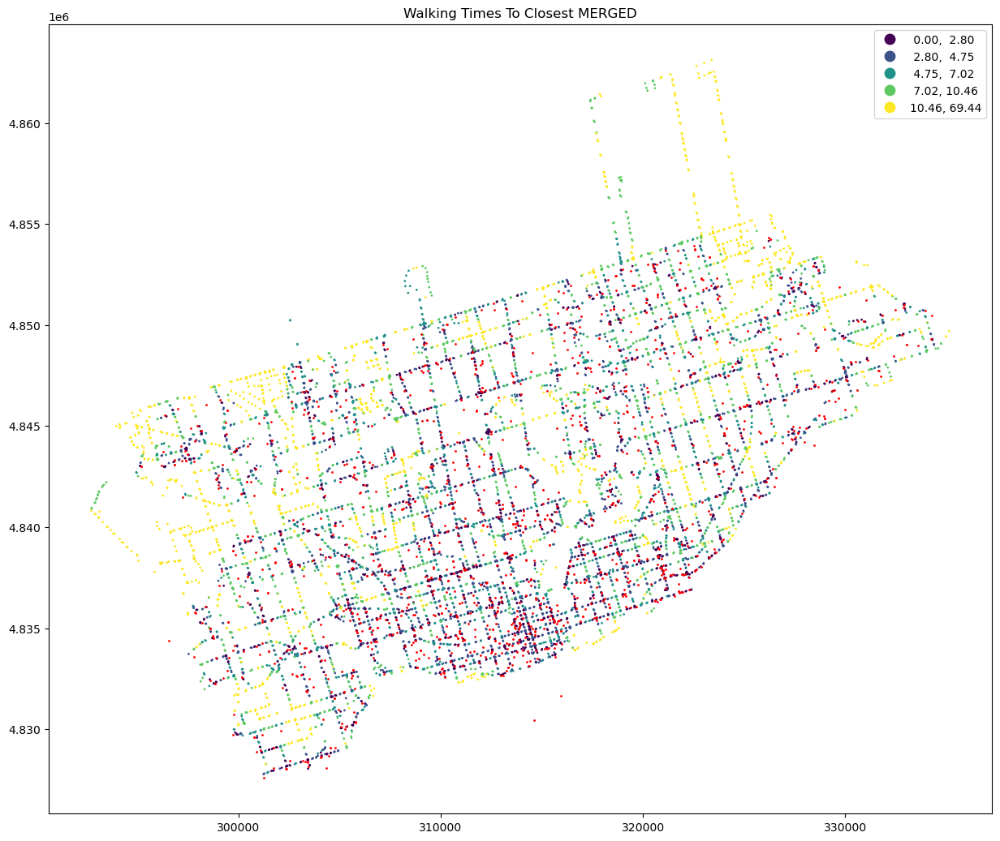

In [36]:
# Walking times To closest MERGED with MERGEDs added
import mapclassify
ax = ttc_stop.plot(figsize=(15, 15), column='m_ttcstop_0', scheme='quantiles', legend=True,markersize = 1)
MERGED.plot(ax=ax, color='red', markersize =1)
plt.title('Walking Times To Closest MERGED')

## Walking Times To Closest MERGED with Neighbourhood Improvement Areas

In this step we will invesitgate the walk times in the Neighbourhood Improvement Areas.

## Get the Neighbourhood Improvement Area centre points

To place a label on each Neighbourhood Improvement Areas in the plot we need to find an identifiable point which exists within each polygon so that we can say where we want the text to be placed.

In [37]:
# Here we find the center points, copy our original df to a new df, and then set
# the geometry column to the newly created center points column
# (because a GeoPandas df can only have one geometry column)
nia["center"] = nia["geometry"].centroid
nia_points = nia.copy()
nia_points.set_geometry("center", inplace = True)

Text(0.5, 1.0, 'Walking Times To Closest MERGED \n within Neighbourhood Improvement Areas')

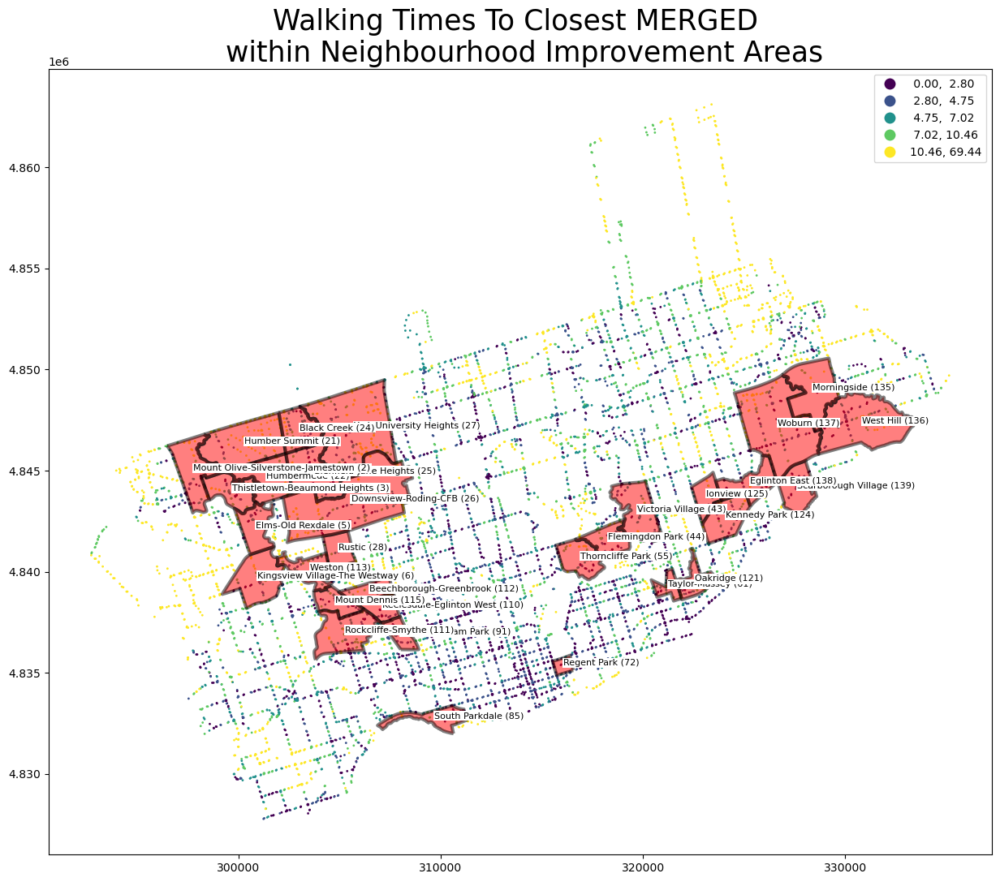

In [38]:
# ploting and adding labels for Neighbourhood Improvement Areas
ax = ttc_stop.plot(figsize=(15, 15), column='m_ttcstop_0', scheme='quantiles', legend=True,markersize = 1)
nia.plot(ax=ax, edgecolor='black', facecolor='red', linewidth=3, alpha=.5 )
texts = []

# Plot labels and add a white box behind the label using the matplotlib bbox class.
for x, y, label in zip(nia_points.geometry.x, nia_points.geometry.y, nia_points["area_name"]):
    texts.append(plt.text(x, y, label, fontsize = 8, bbox=dict(boxstyle='square,pad=0.1', fc='white', ec='none')))

ax.set_title('Walking Times To Closest MERGED \n within Neighbourhood Improvement Areas', fontdict={'fontsize': '25', 'fontweight' : '3'})

#plt.savefig("./walkability_nia.png", dpi=300)

# ttc_stopes within Neighbourhood Improvement Areas

We will now perform a spatial join between Neighbourhood Improvement Area layer and ttc_stop layer in order to allocate ttc_stopes to Neighbourhood Improvement Areas.

In [39]:
# Spatial Join where Neighbourhood Improvement Area polygons are intersected with ttc_stop points
nia_ttc_stop = gpd.sjoin(nia, ttc_stop, op='intersects', how='left')
nia_ttc_stop

C:\Users\humbe\anaconda3\envs\environment\lib\site-packages\IPython\core\interactiveshell.py:3472: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


,area_id,area_s_cd,area_name,geometry,center,index_right,stop_id,stop_code,stop_name,latitude,...,m_ttcstop_0,m_ttcstop_1,m_ttcstop_2,m_ttcstop_3,m_ttcstop_4,m_ttcstop_5,m_ttcstop_6,m_ttcstop_7,m_ttcstop_8,m_ttcstop_9
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),2006,2807,1284,Martin Ross Ave at Flint Rd,43.772840,...,23.044098,27.503721,27.664695,28.962752,31.619415,33.222751,34.332777,35.231778,36.351834,37.819041
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),2505,3407,1279,Martin Ross Ave at Brisbane Rd (West),43.773418,...,18.479584,24.398236,27.054903,27.443195,30.667263,31.787320,32.068237,33.254527,37.787265,37.854360
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),6820,8667,1280,Martin Ross Ave at Brisbane Rd (West),43.773686,...,18.479584,24.398236,27.054903,27.443195,30.667263,31.787320,32.068237,33.254527,37.787265,37.854360
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),7441,9426,1275,Martin Ross Ave at Alness St,43.774135,...,14.847805,20.766459,23.625556,24.013847,27.237917,28.357973,29.825182,34.425015,35.700012,38.384071
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),8545,14366,14840,Martin Ross Ave at Alness St West Side,43.774145,...,14.847805,20.766459,23.625556,24.013847,27.237917,28.357973,29.825182,34.425015,35.700012,38.384071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2626,3557,4842,Brimorton Dr at Scarborough Golf Club Rd,43.770016,...,10.198722,13.572194,17.279126,18.681374,19.378320,20.064416,22.319070,23.024806,24.810223,25.492445
30,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),1871,2647,4839,Brimorton Dr at Linville Rd,43.770420,...,11.823458,15.196930,18.903861,20.306112,21.003055,21.689153,22.449722,23.155458,26.434959,26.988388
30,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2844,3829,4838,Brimorton Dr at Dalehurst Ave,43.770891,...,14.310250,17.683723,19.962931,20.668667,21.390652,22.023749,22.792903,24.175944,25.085319,28.921750
30,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2337,3203,4840,Brimorton Dr at Mid Pines Rd,43.771233,...,17.080236,17.192944,17.785972,19.141056,20.566416,22.202625,24.273348,25.675596,27.058640,28.038890


# Count of ttc_stopes in Neighbourhood Improvement Areas

We will now do a count of ttc_stopes within each Neighbourhood Improvement Areas and visualize the results in a bar plot.

In [40]:
# count of ttc_stopes assigned to each Neighbourhood Improvement Area
value_counts = nia_ttc_stop.area_name.value_counts()
value_counts

York University Heights (27)             217
Downsview-Roding-CFB (26)                165
Woburn (137)                             139
Rockcliffe-Smythe (111)                  101
Humber Summit (21)                        93
Black Creek (24)                          83
Glenfield-Jane Heights (25)               80
West Hill (136)                           73
Kennedy Park (124)                        71
Victoria Village (43)                     64
Mount Olive-Silverstone-Jamestown (2)     63
Weston (113)                              61
Thorncliffe Park (55)                     55
Oakridge (121)                            54
Kingsview Village-The Westway (6)         50
Humbermede (22)                           49
Mount Dennis (115)                        46
Eglinton East (138)                       46
Thistletown-Beaumond Heights (3)          44
Flemingdon Park (44)                      43
South Parkdale (85)                       39
Taylor-Massey (61)                        32
Morningsid

In [41]:
# count of ttc_stopes assigned to each Neighbourhood Improvement Area
value_counts = nia_ttc_stop.area_name.value_counts()
value_counts

# renaming axixs to area_name and resetting index to nia_ttc_stop_count
nia_ttc_stop_counts = value_counts.rename_axis('area_name').reset_index(name='nia_ttc_stop_count')
nia_ttc_stop_counts

# merge nia_ttc_stop_counts with nia_ttc_stop using the area_name which is shared by both dataframes
nia_ttc_stop = pd.merge(nia_ttc_stop, nia_ttc_stop_counts)

nia_ttc_stop

,area_id,area_s_cd,area_name,geometry,center,index_right,stop_id,stop_code,stop_name,latitude,...,m_ttcstop_1,m_ttcstop_2,m_ttcstop_3,m_ttcstop_4,m_ttcstop_5,m_ttcstop_6,m_ttcstop_7,m_ttcstop_8,m_ttcstop_9,nia_ttc_stop_count
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),2006,2807,1284,Martin Ross Ave at Flint Rd,43.772840,...,27.503721,27.664695,28.962752,31.619415,33.222751,34.332777,35.231778,36.351834,37.819041,217
1,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),2505,3407,1279,Martin Ross Ave at Brisbane Rd (West),43.773418,...,24.398236,27.054903,27.443195,30.667263,31.787320,32.068237,33.254527,37.787265,37.854360,217
2,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),6820,8667,1280,Martin Ross Ave at Brisbane Rd (West),43.773686,...,24.398236,27.054903,27.443195,30.667263,31.787320,32.068237,33.254527,37.787265,37.854360,217
3,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),7441,9426,1275,Martin Ross Ave at Alness St,43.774135,...,20.766459,23.625556,24.013847,27.237917,28.357973,29.825182,34.425015,35.700012,38.384071,217
4,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),8545,14366,14840,Martin Ross Ave at Alness St West Side,43.774145,...,20.766459,23.625556,24.013847,27.237917,28.357973,29.825182,34.425015,35.700012,38.384071,217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1902,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2626,3557,4842,Brimorton Dr at Scarborough Golf Club Rd,43.770016,...,13.572194,17.279126,18.681374,19.378320,20.064416,22.319070,23.024806,24.810223,25.492445,31
1903,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),1871,2647,4839,Brimorton Dr at Linville Rd,43.770420,...,15.196930,18.903861,20.306112,21.003055,21.689153,22.449722,23.155458,26.434959,26.988388,31
1904,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2844,3829,4838,Brimorton Dr at Dalehurst Ave,43.770891,...,17.683723,19.962931,20.668667,21.390652,22.023749,22.792903,24.175944,25.085319,28.921750,31
1905,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2337,3203,4840,Brimorton Dr at Mid Pines Rd,43.771233,...,17.192944,17.785972,19.141056,20.566416,22.202625,24.273348,25.675596,27.058640,28.038890,31


<AxesSubplot:title={'center':'ttc_stop Count in Neighbourhood Improvement Areas'}, xlabel='Neighbourhood Improvement Areas', ylabel='Number'>

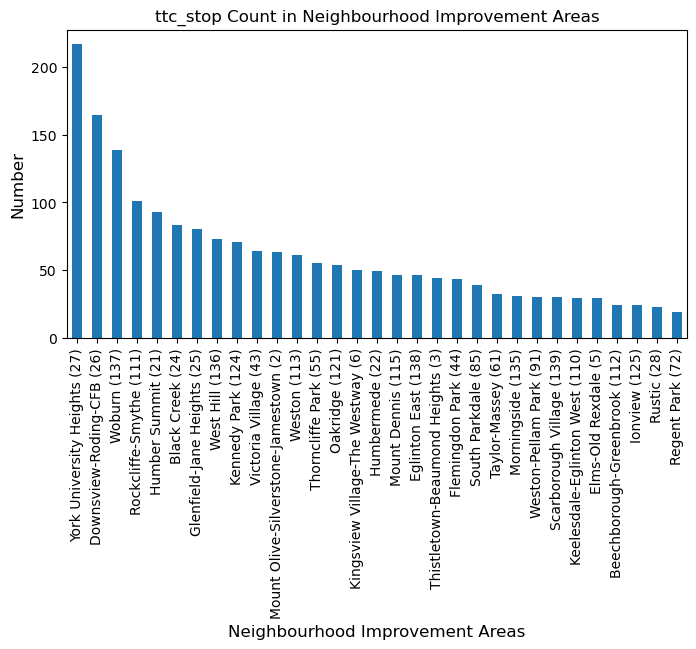

In [42]:
# distribution of ttc_stopes in nia_ttc_stop

#plot
plt.figure(figsize=(8,4))

plt.title("ttc_stop Count in Neighbourhood Improvement Areas")
plt.ylabel('Number', fontsize=12)
plt.xlabel('Neighbourhood Improvement Areas', fontsize=12)

nia_ttc_stop.area_name.value_counts().plot.bar()

Text(0.5, 1.0, 'Walking Times To Closest MERGED')

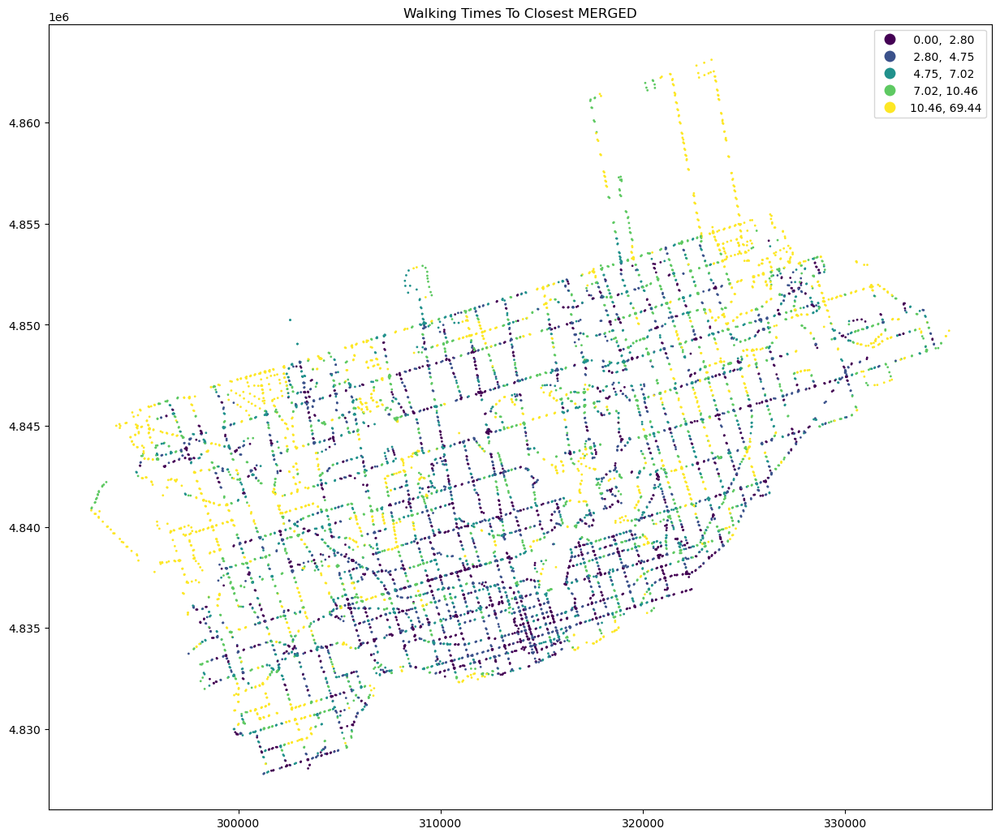

In [43]:
# Walking Times To Closest MERGED
ax = ttc_stop.plot(figsize=(15, 15), column='m_ttcstop_0', scheme='quantiles', legend=True,markersize = 1)
plt.title('Walking Times To Closest MERGED')

# Average Walking Times To Closest MERGED in Neighbourhood Improvement Areas

We will now use the mean function to calculate the mean walking time to the closest MERGED for each of the Neighbourhood Improvement Areas.

In [44]:
mins_avgs = nia_ttc_stop.groupby('area_name')['m_ttcstop_0'].mean()
mins_avgs

area_name
Beechborough-Greenbrook (112)             7.511681
Black Creek (24)                          6.307553
Downsview-Roding-CFB (26)                 8.645861
Eglinton East (138)                       6.420618
Elms-Old Rexdale (5)                      5.798687
Flemingdon Park (44)                      4.875892
Glenfield-Jane Heights (25)               6.667762
Humber Summit (21)                       17.360661
Humbermede (22)                           8.856245
Ionview (125)                             6.275775
Keelesdale-Eglinton West (110)            4.356493
Kennedy Park (124)                        5.718985
Kingsview Village-The Westway (6)         6.938623
Morningside (135)                         8.474287
Mount Dennis (115)                        4.834170
Mount Olive-Silverstone-Jamestown (2)     6.659762
Oakridge (121)                            5.768695
Regent Park (72)                          2.937688
Rockcliffe-Smythe (111)                   6.866467
Rustic (28)          

In [45]:
# renaming axixs to area_name and resetting index to nia_addr_avg_min
nia_addr_avg_min = mins_avgs.rename_axis('area_name').reset_index(name='nia_addr_avg_min')
nia_addr_avg_min

# merge nia_ttc_stop with nia_addr_avg_min using area_name
nia_ttc_stop = pd.merge(nia_ttc_stop, nia_addr_avg_min)

nia_ttc_stop

,area_id,area_s_cd,area_name,geometry,center,index_right,stop_id,stop_code,stop_name,latitude,...,m_ttcstop_2,m_ttcstop_3,m_ttcstop_4,m_ttcstop_5,m_ttcstop_6,m_ttcstop_7,m_ttcstop_8,m_ttcstop_9,nia_ttc_stop_count,nia_addr_avg_min
0,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),2006,2807,1284,Martin Ross Ave at Flint Rd,43.772840,...,27.664695,28.962752,31.619415,33.222751,34.332777,35.231778,36.351834,37.819041,217,9.316703
1,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),2505,3407,1279,Martin Ross Ave at Brisbane Rd (West),43.773418,...,27.054903,27.443195,30.667263,31.787320,32.068237,33.254527,37.787265,37.854360,217,9.316703
2,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),6820,8667,1280,Martin Ross Ave at Brisbane Rd (West),43.773686,...,27.054903,27.443195,30.667263,31.787320,32.068237,33.254527,37.787265,37.854360,217,9.316703
3,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),7441,9426,1275,Martin Ross Ave at Alness St,43.774135,...,23.625556,24.013847,27.237917,28.357973,29.825182,34.425015,35.700012,38.384071,217,9.316703
4,25886593,027,York University Heights (27),"POLYGON ((304374.200 4846441.251, 304406.841 4...",POINT (305695.095 4847092.650),8545,14366,14840,Martin Ross Ave at Alness St West Side,43.774145,...,23.625556,24.013847,27.237917,28.357973,29.825182,34.425015,35.700012,38.384071,217,9.316703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1902,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2626,3557,4842,Brimorton Dr at Scarborough Golf Club Rd,43.770016,...,17.279126,18.681374,19.378320,20.064416,22.319070,23.024806,24.810223,25.492445,31,8.474287
1903,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),1871,2647,4839,Brimorton Dr at Linville Rd,43.770420,...,18.903861,20.306112,21.003055,21.689153,22.449722,23.155458,26.434959,26.988388,31,8.474287
1904,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2844,3829,4838,Brimorton Dr at Dalehurst Ave,43.770891,...,19.962931,20.668667,21.390652,22.023749,22.792903,24.175944,25.085319,28.921750,31,8.474287
1905,25886466,135,Morningside (135),"POLYGON ((326891.120 4849741.351, 326893.887 4...",POINT (328381.142 4848985.391),2337,3203,4840,Brimorton Dr at Mid Pines Rd,43.771233,...,17.785972,19.141056,20.566416,22.202625,24.273348,25.675596,27.058640,28.038890,31,8.474287


<AxesSubplot:xlabel='area_name'>

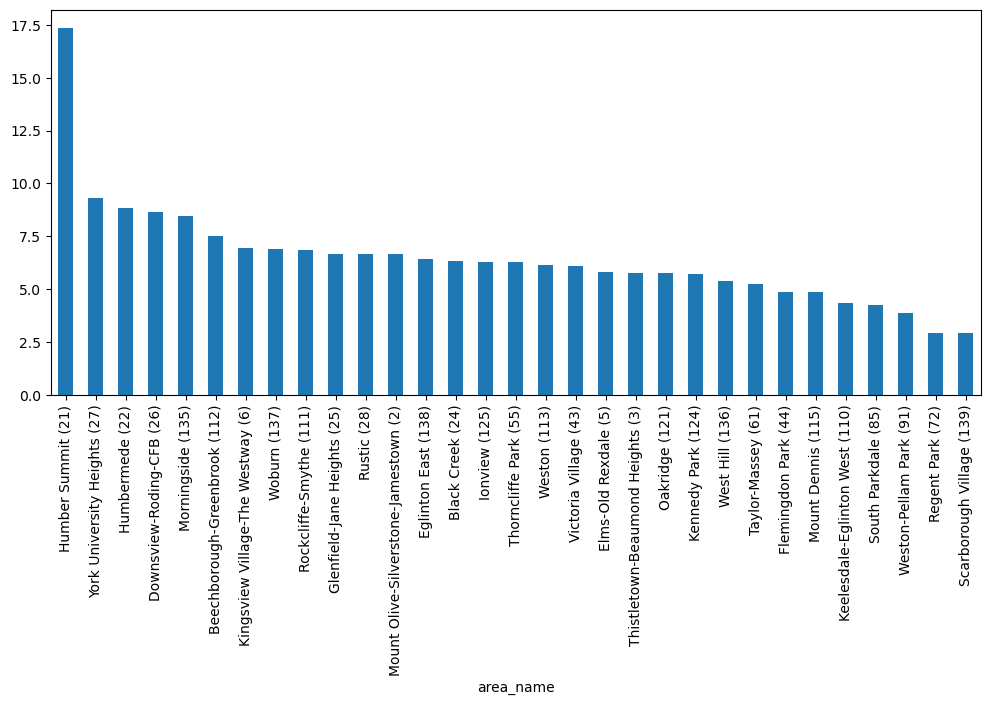

In [46]:
# plot bar plot
plt.figure(figsize=(12,5))
nia_ttc_stop_bar = nia_ttc_stop.groupby(['area_name'])['m_ttcstop_0'].mean()

nia_ttc_stop_bar.sort_values(ascending=False).plot.bar()

# Plot Average Walking times to the Closest MERGED for each Neighbourhood Improvement Area

Text(0.1, 0.08, 'Source: Toronto Open Data')

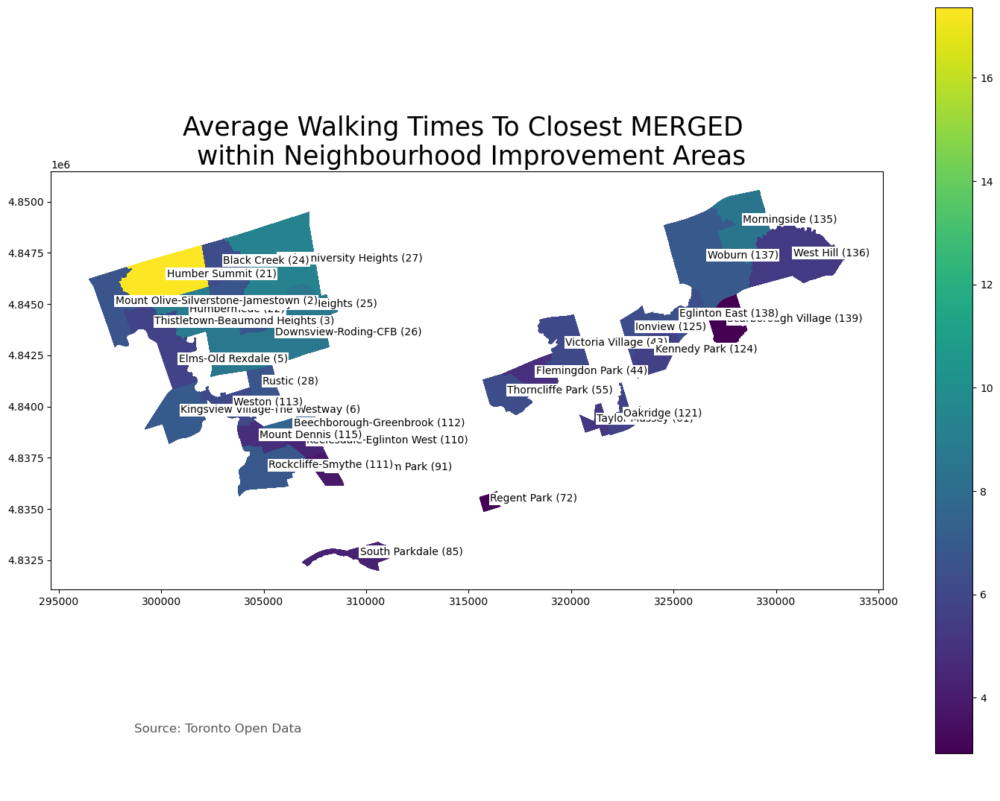

In [47]:
# plot Average Walking Times To Closest MERGED in Neighbourhood Improvement Areas
ax = nia_ttc_stop.plot(figsize=(18, 13), column='nia_addr_avg_min', legend=True)
ax.set_title('Average Walking Times To Closest MERGED \n within Neighbourhood Improvement Areas', fontdict={'fontsize': '25', 'fontweight' : '3'})

# Plot labels and add a white box behind the label using the matplotlib bbox class.
for x, y, label in zip(nia_points.geometry.x, nia_points.geometry.y, nia_points["area_name"]):
    texts.append(plt.text(x, y, label, fontsize = 10, bbox=dict(boxstyle='square,pad=0.1', fc='white', ec='none')))
# create an annotation for the data source
ax.annotate('Source: Toronto Open Data',xy=(0.1, .08),  xycoords='figure fraction', horizontalalignment='left', verticalalignment='top', fontsize=12, color='#555555')

# Get bounds of each Neighbourhood Improvement Area polygon

We will list all of the Neighbourhood Improvement Areas. Select the index_left value corresponding to the Neighbourhood Improvement Area you want to display in the dataframe bell. We will use the bounding box function to obtain the polygon coordinates for each Neighbourhood Improvement Area. We will then use the bound box coordinates for a particular Neighbourhood Improvement Area polygon to show the walking times within the Neighbourhood Improvement Area.

In [48]:
# index_left and area_name
nia.area_name

0              York University Heights (27)
1          Thistletown-Beaumond Heights (3)
2                     Thorncliffe Park (55)
3                               Rustic (28)
4                 Scarborough Village (139)
5                       South Parkdale (85)
6                        Taylor-Massey (61)
7                        Humber Summit (21)
8                           Humbermede (22)
9                      Flemingdon Park (44)
10                            Ionview (125)
11              Glenfield-Jane Heights (25)
12                    Victoria Village (43)
13                          West Hill (136)
14                       Kennedy Park (124)
15        Kingsview Village-The Westway (6)
16           Keelesdale-Eglinton West (110)
17                       Mount Dennis (115)
18            Beechborough-Greenbrook (112)
19                           Oakridge (121)
20                      Eglinton East (138)
21                     Elms-Old Rexdale (5)
22                         Regen

In [49]:
# Get bounding box coordinates and area name for a particular Neighbourhood Improvement Area
# Pick index number from the list above and place it in the []
minx,miny,maxx,maxy = nia.bounds.iloc[4].values
# Pick the same index number from the list above and place it in the [] to get the area name
nia_area_name = nia.area_name.iloc[4]
nia_area_name

'Scarborough Village (139)'

# Plotting Neighbourhood Improvement Area using bounding box co-ordinates

Text(0.1, 0.05, 'Source: Toronto Open Data')

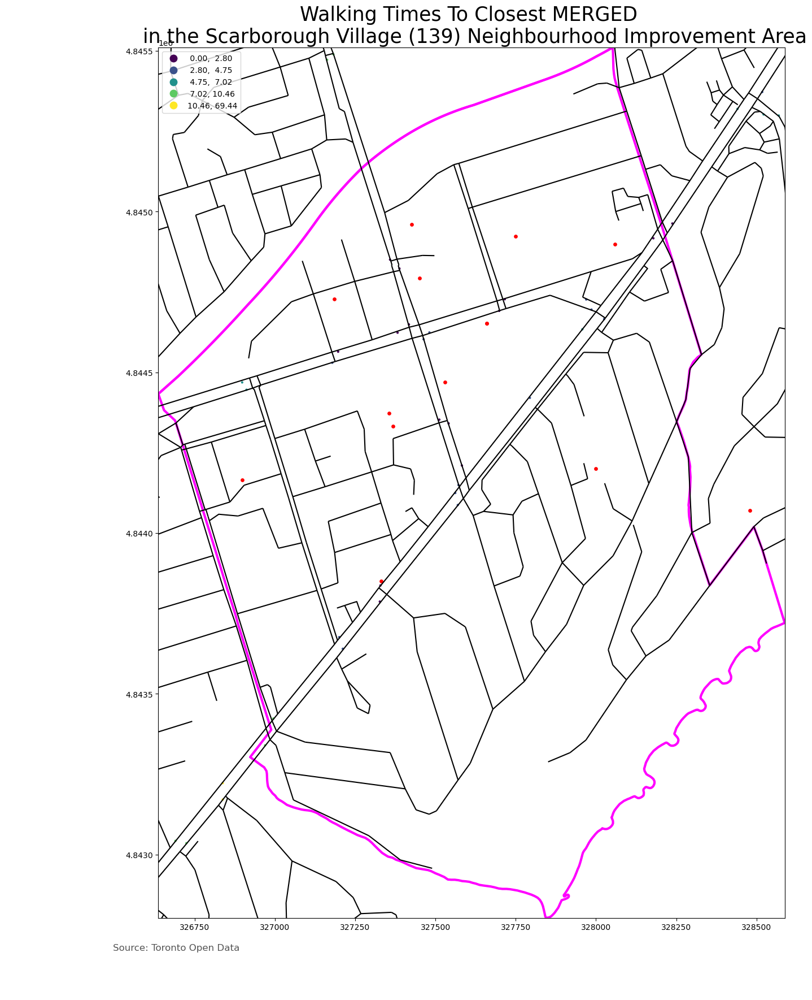

In [50]:
### plotting Neighbourhood Improvement Area using bounding box co-ordinates
#name = nia_area_name
ax = ttc_stop.plot(figsize=(20, 20), column='m_ttcstop_0', scheme='quantiles', legend=True,markersize = 4)
nia.plot(ax=ax, facecolor='none', edgecolor='magenta', linewidth=3)
MERGED.plot(ax=ax, color='red', markersize =15)
pednet.plot(ax=ax,color='black', markersize =1)

# getting limits
ax.set(xlim=(minx, maxx), ylim=(miny, maxy))

# add a title
ax.set_title((('Walking Times To Closest MERGED \n in the {0} Neighbourhood Improvement Area').format(nia_area_name)), fontdict={'fontsize': '25', 'fontweight' : '3'})
# create an annotation for the data source
ax.annotate('Source: Toronto Open Data',xy=(0.1, .05),  xycoords='figure fraction', horizontalalignment='left', verticalalignment='top', fontsize=12, color='#555555')

#option to save figure
#fig.savefig("./MERGED_walkability.png", dpi=300)